In [2]:
from pathlib import Path
from typing import List
from PIL import Image

import torch
from torch.utils.data import DataLoader
from dataset import get_dataset
from models import VAE
from seed import get_seeded_generator, seeded_worker_init_fn, seed_everything
import yaml

from utils import unnorm, to_numpy

In [5]:
config = f"configs/VAE/CelebA/baseline.yaml"
ckpt = f"checkpoints/CelebA/VAE/best.ckpt"
device = torch.device("mps")

In [6]:
with open(config, "r") as fs:
    config = yaml.safe_load(fs)

seed_everything(config["training"]["seed"])

model = VAE(
    image_channels=config["image"]["channels"],
    image_size=(
        config["image"]["size"],
        config["image"]["size"]
    ),
    **config["model"]
)
model.load_state_dict(
    torch.load(ckpt, map_location=device)["model_state_dict"]
)

<All keys matched successfully>

In [7]:
train_dataset, test_dataset = get_dataset(
    config["dataset"]["name"],
    Path(config["dataset"]["datasets_dir"]),
    config["image"]["size"]
)

train_dataloader = DataLoader(
    train_dataset,
    batch_size=config["training"]["batch_size"],
    worker_init_fn=seeded_worker_init_fn,
    generator=get_seeded_generator(config["training"]["seed"]),
    shuffle=True,
    pin_memory=config["training"]["pin_memory"],
    num_workers=config["training"]["num_workers"],
    prefetch_factor=(
        config["training"]["prefetch_factor"] if config["training"]["prefetch_factor"] else None
    ),
)
test_dataloader = DataLoader(
    test_dataset,
    batch_size=config["training"]["batch_size"],
    worker_init_fn=seeded_worker_init_fn,
    generator=get_seeded_generator(config["training"]["seed"]),
    num_workers=config["training"]["num_workers"],
    prefetch_factor=(
        config["training"]["prefetch_factor"] if config["training"]["prefetch_factor"] else None
    ),
)

Files already downloaded and verified
Files already downloaded and verified


In [8]:
attr_index = {
    attr: idx
    for (idx, attr) in enumerate(test_dataset.attr_names)
}

In [9]:
from typing import Dict, Optional
from tqdm import tqdm
from torch.utils.data import Dataset
from dataclasses import dataclass
import torch


def get_faces_with_attrs(
    dataset: Dataset,
    attrs: Dict[str, int],
    attr_index: Dict[str, int],
    limit: Optional[int] = None
) -> torch.Tensor:
    xs: List[torch.Tensor] = []
    for (x, y) in dataset:
        if limit is not None and len(xs) == limit:
            break
        if all([
            y[attr_index[attr]] == value
            for attr, value in attrs.items()
        ]):
            xs.append(x.unsqueeze(0))
    return torch.cat(xs, dim=0)


def get_latents(
    model: VAE,
    dataloader: DataLoader,
    device: torch.device
) -> torch.Tensor:
    latents: List[torch.Tensor] = []

    model = model.to(device)
    model.eval()

    with torch.inference_mode():
        for x in tqdm(iter(dataloader)):
            x = x.to(device)
            q = model.encode(x)
            z = q.sample()
            latents.append(z)

    return torch.cat(latents, dim=0)


@dataclass
class TranslationResults:
    original_images: torch.Tensor
    original_latents: torch.Tensor
    original_latent: torch.Tensor
    desired_images: torch.Tensor
    desired_latents: torch.Tensor
    desired_latent: torch.Tensor
    translated_images: torch.Tensor
    translated_images_with_original: torch.Tensor


def translate(
    model: VAE,
    dataset,
    original_attrs: Dict[str, int],
    desired_attrs: Dict[str, int],
    attr_index: Dict[str, int],
    translation_weights: torch.Tensor,
    original_pos: int,
    batch_size: int,
    device: torch.device,
    limit: Optional[int] = None
):
    original_images = get_faces_with_attrs(
        dataset,
        original_attrs,
        attr_index,
        limit
    )
    desired_images = get_faces_with_attrs(
        dataset,
        desired_attrs,
        attr_index,
    )

    assert len(original_images) > 0
    assert len(desired_images) > 0

    original_latents = get_latents(
        model,
        DataLoader(original_images, batch_size=batch_size),
        device
    )
    original_latent = original_latents.mean(dim=0)

    desired_latents = get_latents(
        model,
        DataLoader(desired_images, batch_size=batch_size),
        device
    )
    desired_latent = desired_latents.mean(dim=0)
    [latent_dim] = desired_latent.shape

    deltas = (
        # [N, 1] * [1, D] => [N, D]
        translation_weights.unsqueeze(1) * desired_latent.unsqueeze(0)
    )

    # [num_examples, 1, D] + [N, D] => [num_examples, N, D]
    translated_latents = original_latents.unsqueeze(1) + deltas
    translated_latents = translated_latents.view(
        (-1, latent_dim))  # [num_examples * N, D]
    translated_images: List[torch.Tensor] = []

    with torch.inference_mode():
        for z in iter(DataLoader(translated_latents, batch_size=batch_size)):
            q = model.decode(z)
            x = q.loc
            translated_images.append(x)

    translated_images = torch.cat(translated_images, dim=0)  # []
    [_, C, H, W] = translated_images.shape
    translated_images = translated_images.view(
        (len(original_images), -1, C, H, W)  # [N, 8, C, H, W]
    )
    num_translations_per_image = len(translation_weights)

    translation_before_original_pos: Optional[torch.Tensor] = None
    translations_after_original_pos: Optional[torch.Tensor] = None

    if original_pos == 0:
        translations_after_original_pos = translated_images[
            torch.arange(len(original_images)).repeat_interleave(
                num_translations_per_image - original_pos),
            list(range(original_pos, num_translations_per_image)) *
            len(original_images),
            ...
        ].view((len(original_images), num_translations_per_image - original_pos, C, H, W))
        translations_with_original = torch.cat([
            original_images.unsqueeze(1).to(device),  # [N, 1, C, H, W],
            translations_after_original_pos
        ], dim=1)

    if original_pos == num_translations_per_image:
        translation_before_original_pos = translated_images[
            torch.arange(len(original_images)).repeat_interleave(original_pos),
            list(range(0, original_pos)) *
            len(original_images),
            ...
        ].view((len(original_images), original_pos, C, H, W))
        translations_with_original = torch.cat([
            translation_before_original_pos,
            original_images.unsqueeze(1).to(device),  # [N, 1, C, H, W],
        ], dim=1)

    translation_before_original_pos = translated_images[
        torch.arange(len(original_images)).repeat_interleave(original_pos),
        list(range(0, original_pos)) *
        len(original_images),
        ...
    ].view((len(original_images), original_pos, C, H, W))

    translations_after_original_pos = translated_images[
        torch.arange(len(original_images)).repeat_interleave(
            num_translations_per_image - original_pos),
        list(range(original_pos, num_translations_per_image)) *
        len(original_images),
        ...
    ].view((len(original_images), num_translations_per_image - original_pos, C, H, W))

    translations_with_original = torch.cat([
        translation_before_original_pos,
        original_images.unsqueeze(1).to(device),  # [N, 1, C, H, W],
        translations_after_original_pos
    ], dim=1)

    return TranslationResults(
        original_images=original_images,
        original_latents=original_latents,
        original_latent=original_latent,
        desired_images=desired_images,
        desired_latents=desired_latents,
        desired_latent=desired_latent,
        translated_images=translated_images,
        translated_images_with_original=translations_with_original
    )

In [18]:
results = translate(
    model,
    test_dataset,
    original_attrs={"Male": 0, "Blond_Hair": 1},
    desired_attrs={"Male": 0, "Black_Hair": 1},
    attr_index=attr_index,
    translation_weights=torch.linspace(0, 2, 8, device=device),
    original_pos=4,
    batch_size=config["training"]["batch_size"],
    device=device,
    limit=8
)

100%|██████████| 12/12 [00:02<00:00,  4.03it/s]


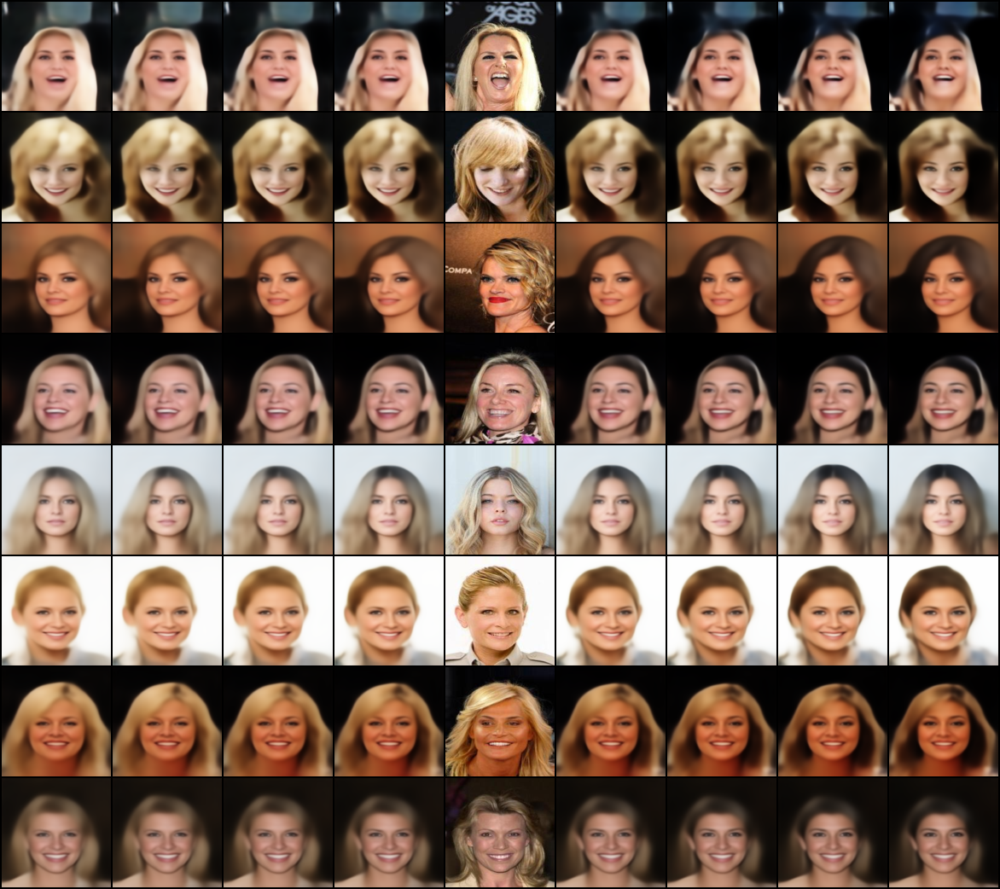

In [19]:
from torchvision.utils import make_grid
Image.fromarray(to_numpy(
    make_grid(
        unnorm(results.translated_images_with_original.flatten(0, 1)),
        nrow=8 + 1
    )
))

In [11]:
results = translate(
    model,
    test_dataset,
    original_attrs={"Smiling": 0},
    desired_attrs={"Smiling": 1},
    attr_index=attr_index,
    translation_weights=torch.linspace(-2, 2, 8, device=device),
    original_pos=4,
    batch_size=config["training"]["batch_size"],
    device=device,
    limit=8
)

100%|██████████| 40/40 [00:10<00:00,  3.71it/s]


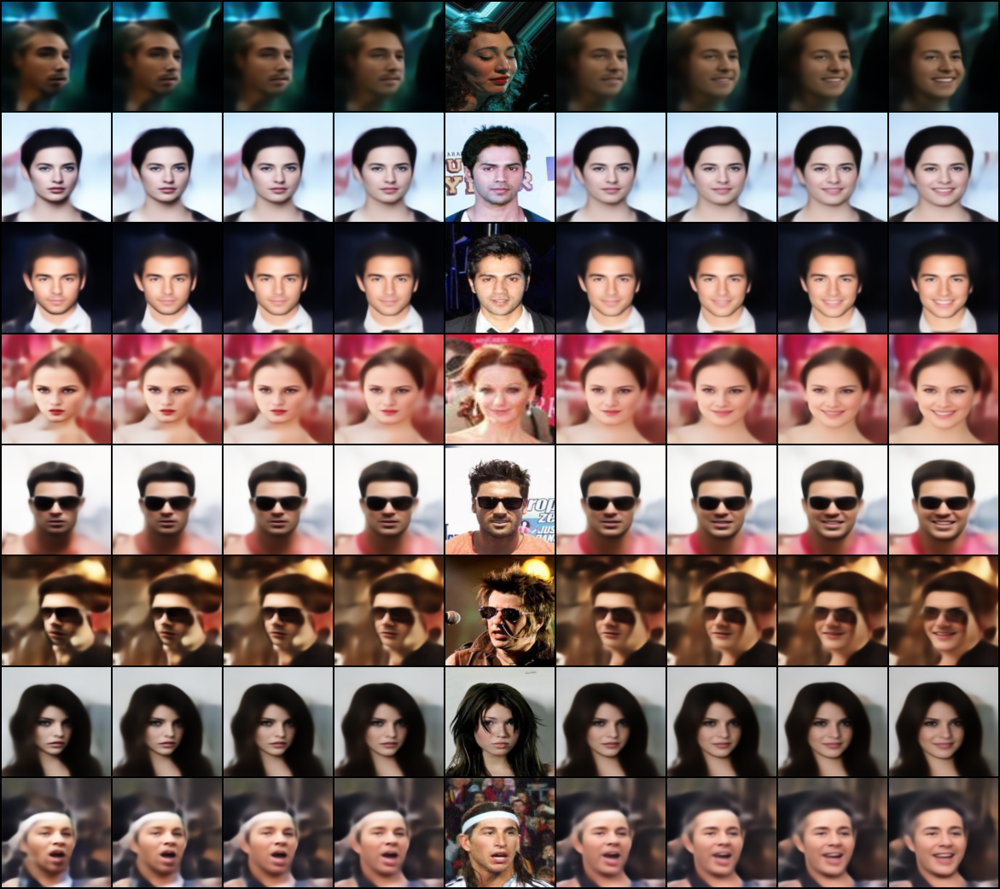

In [12]:
from torchvision.utils import make_grid
Image.fromarray(to_numpy(
    make_grid(
        unnorm(results.translated_images_with_original.flatten(0, 1)),
        nrow=8 + 1
    )
))

In [22]:
results = translate(
    model,
    test_dataset,
    original_attrs={"Male": 1, "Bald": 1},
    desired_attrs={"Male": 1, "Bald": 0},
    attr_index=attr_index,
    translation_weights=torch.linspace(0, 4, 4, device=device),
    original_pos=0,
    batch_size=config["training"]["batch_size"],
    device=device,
    limit=64
)

100%|██████████| 29/29 [00:07<00:00,  3.85it/s]


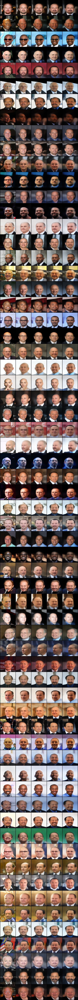

In [23]:
from torchvision.utils import make_grid
Image.fromarray(to_numpy(
    make_grid(
        unnorm(results.translated_images_with_original.flatten(0, 1)),
        nrow=4 + 1
    )
))

In [29]:
results = translate(
    model,
    test_dataset,
    original_attrs={"Male": 0, "Eyeglasses": 0},
    desired_attrs={"Male": 0, "Eyeglasses": 1},
    attr_index=attr_index,
    translation_weights=torch.linspace(0, 3, 8, device=device),
    original_pos=0,
    batch_size=config["training"]["batch_size"],
    device=device,
    limit=16
)

100%|██████████| 2/2 [00:00<00:00,  5.19it/s]


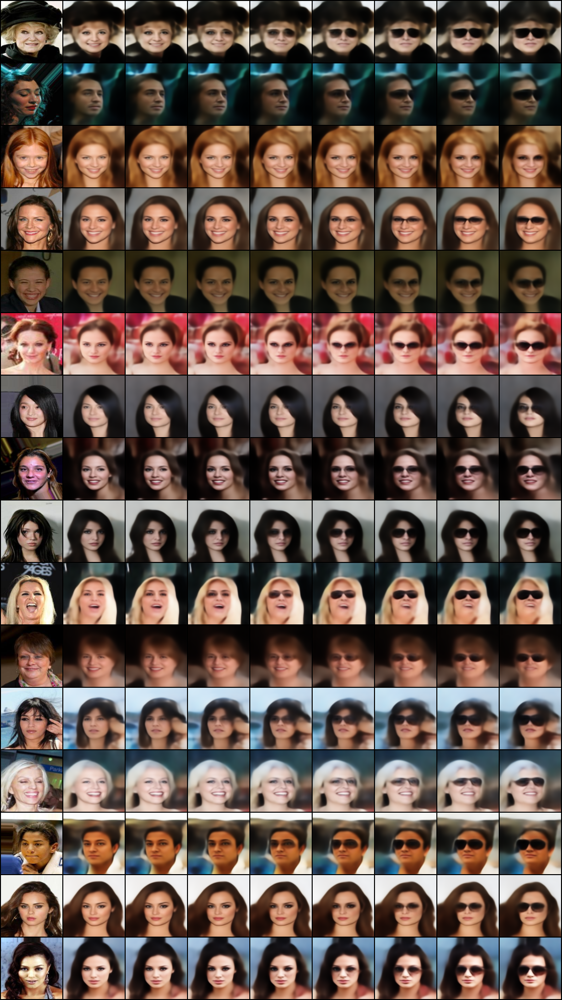

In [31]:
from torchvision.utils import make_grid
Image.fromarray(to_numpy(
    make_grid(
        unnorm(results.translated_images_with_original.flatten(0, 1)),
        nrow=8 + 1
    )
))

In [39]:
results = translate(
    model,
    test_dataset,
    original_attrs={"Male": 1, "Eyeglasses": 0},
    desired_attrs={"Male": 1, "Eyeglasses": 1},
    attr_index=attr_index,
    translation_weights=torch.linspace(0, 3, 4, device=device),
    original_pos=0,
    batch_size=config["training"]["batch_size"],
    device=device,
    limit=32
)

100%|██████████| 4/4 [00:01<00:00,  3.85it/s]


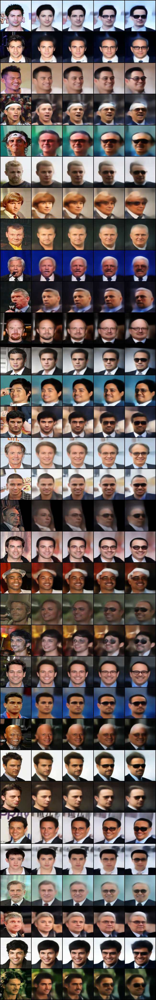

In [40]:
from torchvision.utils import make_grid
Image.fromarray(to_numpy(
    make_grid(
        unnorm(results.translated_images_with_original.flatten(0, 1)),
        nrow=4 + 1
    )
))

In [49]:
results = translate(
    model,
    test_dataset,
    original_attrs={"Male": 1},
    desired_attrs={"Male": 1, "Mustache": 1},
    attr_index=attr_index,
    translation_weights=torch.linspace(-2, 2, 8, device=device),
    original_pos=4,
    batch_size=config["training"]["batch_size"],
    device=device,
    limit=16
)

100%|██████████| 4/4 [00:01<00:00,  2.88it/s]


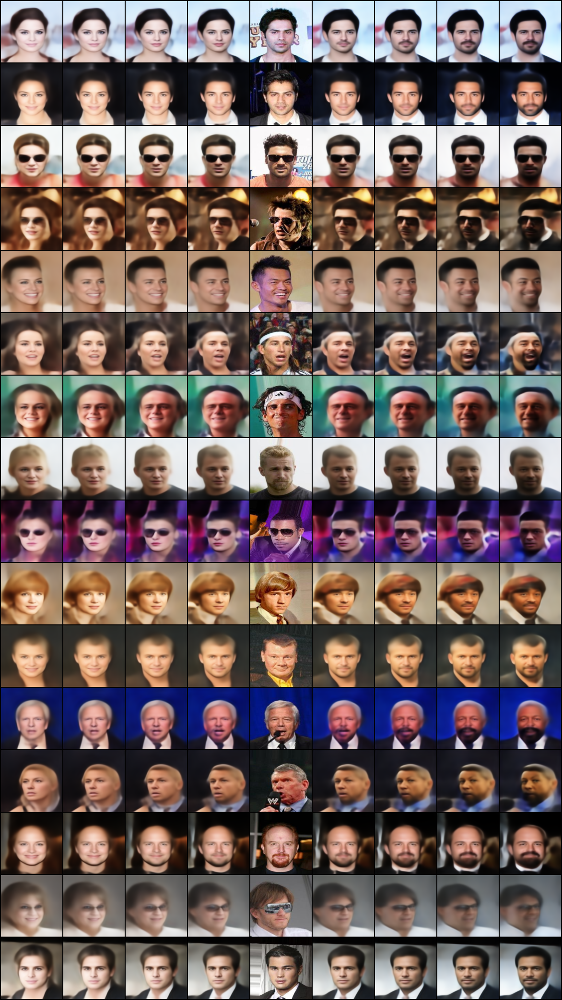

In [50]:
from torchvision.utils import make_grid
Image.fromarray(to_numpy(
    make_grid(
        unnorm(results.translated_images_with_original.flatten(0, 1)),
        nrow=8 + 1
    )
))